# Analytical Chemistry Kernel Library

`Updated on 07/01/2023`

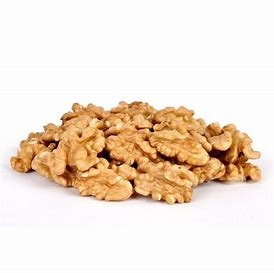

In [1]:
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import cla.metrics
import numpy as np

print('--- use these metrics to compare and evaluate kernels ---')
cla.metrics.metrics_keys()

Unable to determine R home: [WinError 2] The system cannot find the file specified


rpy2 3.X may not support Windows. ECoL metrics may not be available.
--- use these metrics to compare and evaluate kernels ---


Exception ignored from cffi callback <function _consolewrite_ex at 0x0000022F29760C10>:
Traceback (most recent call last):
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte


['classification.ACC',
 'classification.Kappa',
 'classification.F1_Score',
 'classification.Jaccard',
 'classification.Precision',
 'classification.Recall',
 'classification.McNemar',
 'classification.McNemar.CHI2',
 'classification.CochranQ',
 'classification.CochranQ.T',
 'classification.CrossEntropy',
 'classification.Mean_KLD',
 'classification.Brier',
 'classification.ROC_AUC',
 'classification.PR_AUC',
 'classification.BER',
 'classification.SVM.Margin',
 'correlation.IG',
 'correlation.IG.max',
 'correlation.r',
 'correlation.r2',
 'correlation.r.p',
 'correlation.r.max',
 'correlation.r2.max',
 'correlation.r.p.min',
 'correlation.rho',
 'correlation.rho.p',
 'correlation.rho.max',
 'correlation.rho.p.min',
 'correlation.tau',
 'correlation.tau.p',
 'correlation.tau.max',
 'correlation.tau.p.min',
 'test.ES',
 'test.ES.max',
 'test.student',
 'test.student.min',
 'test.student.min.log10',
 'test.student.T',
 'test.student.T.max',
 'test.ANOVA',
 'test.ANOVA.min',
 'test.ANOVA.

# Kernel Response Pattern

Show how each kernel varies with pairwise-point-distances.

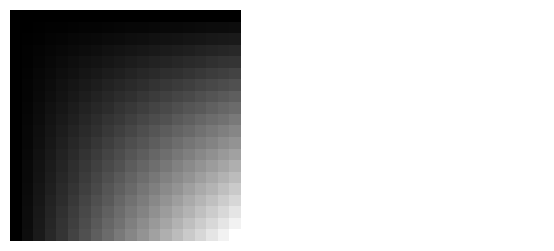

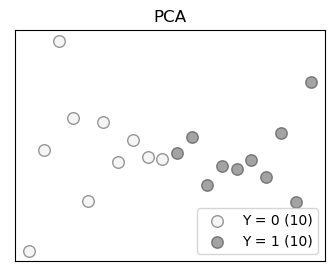

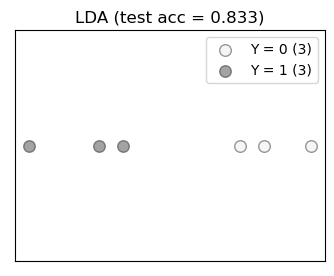

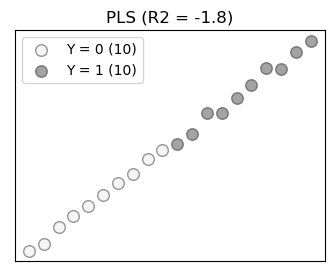

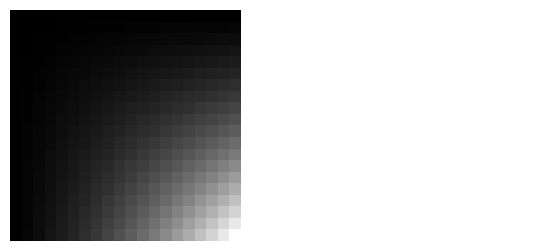

...

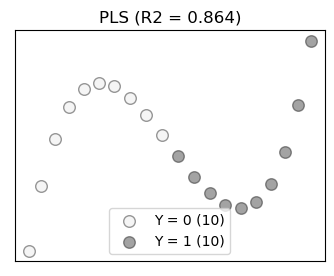

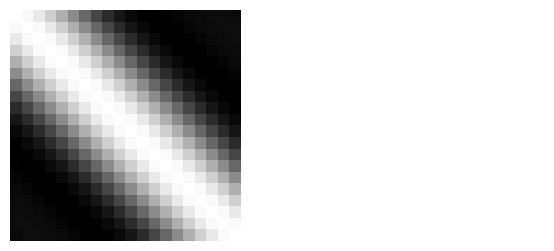

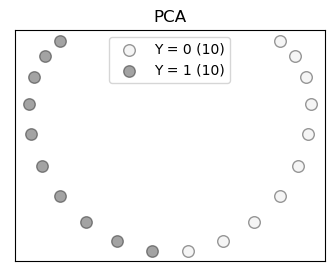

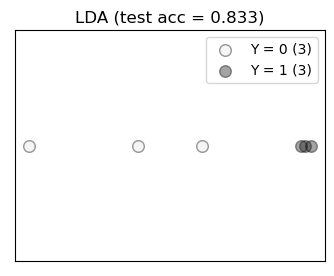

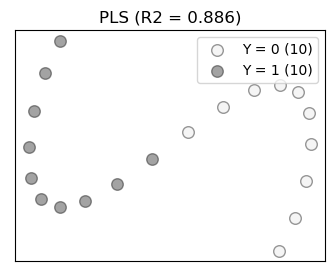

In [2]:
import ackl.metrics

ackl.metrics.linear_response_pattern(20)

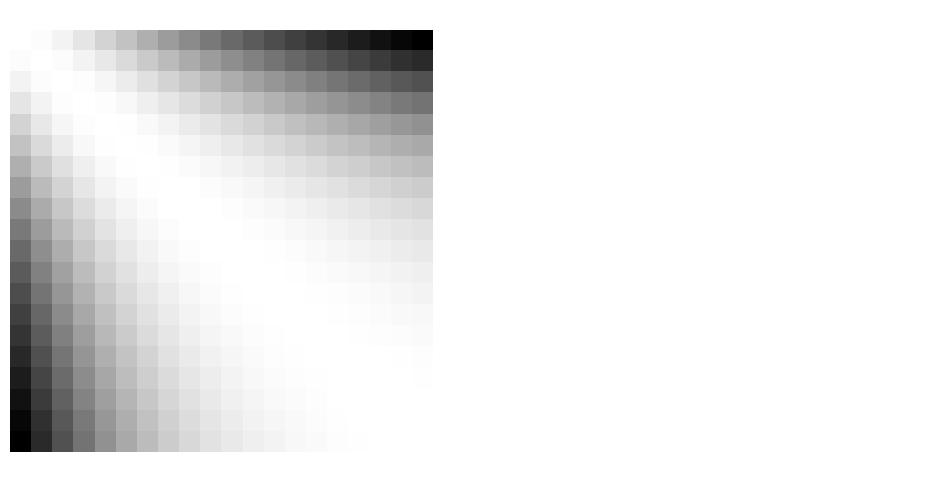

In [3]:
ackl.metrics.cosine_kernel_response_pattern(n = 20, cmap = 'gray', logplot = False, embed_title = False)

## Binary Response Pattern

       0      1 
    0  k(0,0) k(0,1)
    1  k(1,0) k(1,1)

# Real Dataset Experiments

In [4]:
from qsi import io
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import ackl.metrics
import cla.metrics
import pickle
import ackl
from IPython.core.display import HTML, display
import os.path
from sklearn.decomposition import PCA
    
def analyze_dataset(id):
    
    display(HTML('<h1>' + id + '</h1><hr/><br/>'))
    
    if id == 'salt':
        X, y, X_names, desc, labels = io.load_dataset('salt', x_range = list(range(400,1000)), shift = 200, display=True)
    elif id == 'vintage':
        X, y, X_names, desc, labels = io.load_dataset('vintage_spi', x_range=list(range(3000)), y_subset = [0,3], display=True) 
    else:
        X, y, X_names, desc, labels = io.load_dataset(id)
        
    '''
    elif id == 'shihu':
        X, y, X_names, desc, labels = io.load_dataset('shihu_c2', shift = 500, display=True)
    elif id == 'huangjing':
        X, y, X_names, desc, labels = io.load_dataset('huangjing2', x_range=list(range(400, 1300)), shift = 2000, display=True)
    '''
        
    _, ms = cla.metrics.get_metrics(X, y, verbose = False)
        
    old_dim = X.shape
    X = PCA(n_components = 0.99).fit_transform(X) # DR to 99% PCA components
    new_dim = X.shape
        
    for pre in ['mm']: # some kernels require non-negative input
        
        pre_desc = ''
    
        if pre == 'mm':
            X = MinMaxScaler().fit_transform(X) 
            pre_desc = 'sklearn.preprocessing.MinMaxScaler'
        elif pre == 'norm':
            X = StandardScaler().fit_transform(X)
            pre_desc = 'sklearn.preprocessing.StandardScaler'
        else:
            pre_desc = 'no preprocessing. use original data.'

        display(HTML('<h2>1. Preprocessing</h2><hr/><p>' + '1.1 PCA: ' + str(old_dim) + ' ==> ' + str(new_dim) + '</p><p>1.2 Feature scaling: ' + pre_desc + '</p><br/>'))
        
        # display(HTML('<h2>2. CLA before kernel' + '</h2><hr/><br/>'))        
        # display(HTML('<p>' + str(ms) + '</p>'))
        
        display(HTML('<h2>2. Try Kernels' + '</h2><hr/><br/>'))
        
        pkl = id + '_' + pre + '_' + ackl.__version__ + '.pkl'
        if True: # not os.path.isfile(pkl): # if pkl already exist, just reload it
        
            KX, dic_test_accs, all_dic_metrics, html_str = ackl.metrics.classify_with_kernels(X, y,embed_title = False, 
                                                                                        output_html = False,
                                                                                        scale = False, 
                                                                                        scatterplot = True,
                                                                                        logplot = False, 
                                                                                        run_clfs = False,
                                                                                        do_cla = True, 
                                                                                        verbose = False)

            # Persist to a local pickle binary file.
            with open(pkl,'wb') as f:
                pickle.dump(all_dic_metrics, f)

        # Load back
        with open (pkl, 'rb') as f:
            all_dic_metrics = pickle.load(f)
        
        display(HTML('<h2>3. Evaluate Metrics' + '</h2><hr/><br/>'))
        html_str = ackl.metrics.visualize_metric_dicts(all_dic_metrics, plot = True)
        display(HTML( html_str ))
        
    display(HTML('<h2>4. Run time' + '</h2><hr/><br/>'))
    dic_time = ackl.metrics.time_cost_kernels(X, repeat=10)
    print('Averaged run time: ', dic_time)
        
    display(HTML('<h3>----------- End of Analysis ----------</h3><br/><br/>'))

load dataset from 7545.csv
X.shape (120, 600)  y.shape (120,)


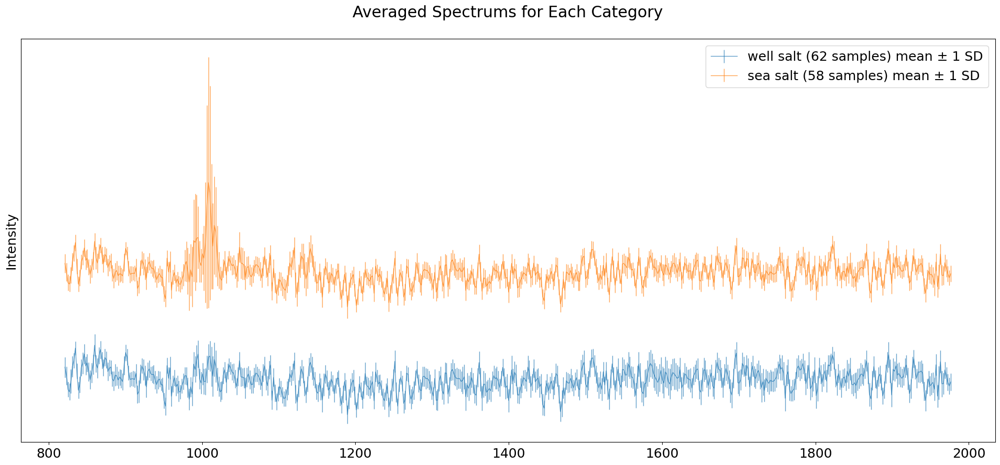

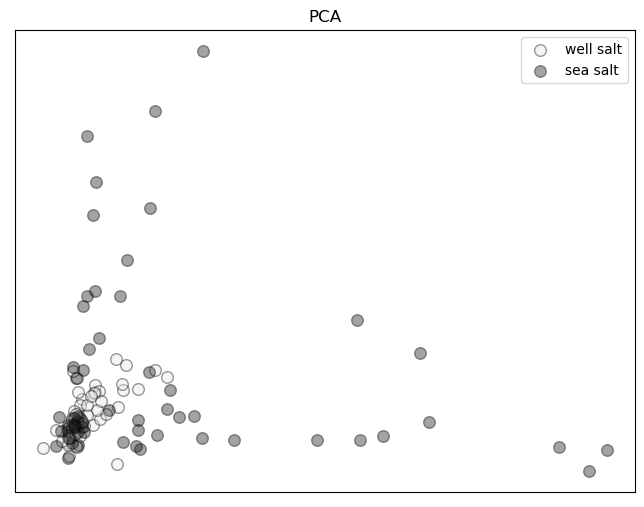

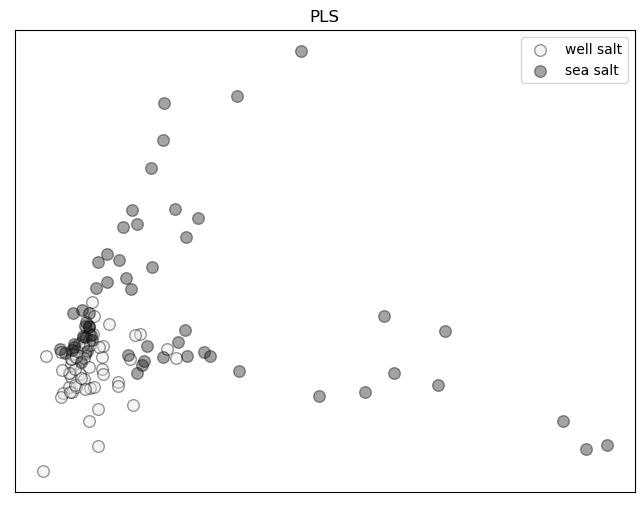

食盐拉曼光谱

C1 - "shenjinkuangyan(zhongyan)：深井矿盐（中盐集团）加碘盐", 
“deep well mineral salt” from CNSIC (China National Salt Industry Co.,Ltd).

C2 - "aozhoutianranhaiyan(huaiyan)：澳洲天然海盐（淮盐）未加碘",
“Australian natural sea salt” from Suyan Group.

DXR2xi显微拉曼成像光谱仪（美国Thermo Fisher公司），
配备有532 nm激光器。
仪器参数设置：
激光功率为10 mw，曝光时间1 s，扫描次数500，
拉曼位移范围为100～3000 cm-1。

--------------------
If you use this data set, please add the reference: 
[1] Analytical chemistry kernel library for spectroscopic profiling data, Food Chemistry Advances, Volume 3, 2023, 100342, ISSN 2772-753X, https://doi.org/10.1016/j.focha.2023.100342


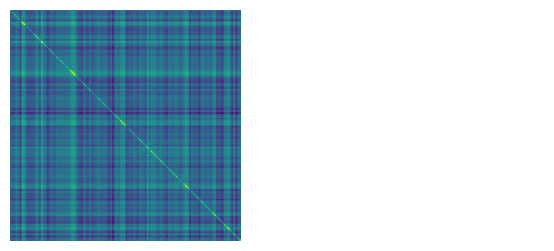

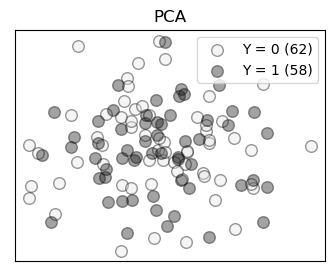

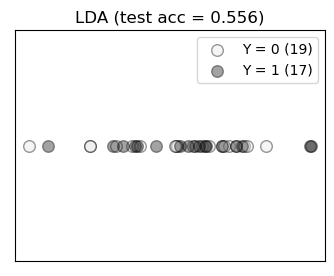

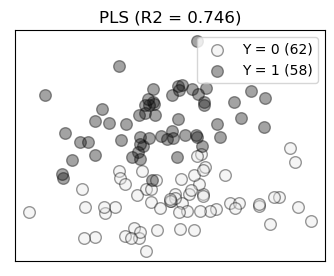

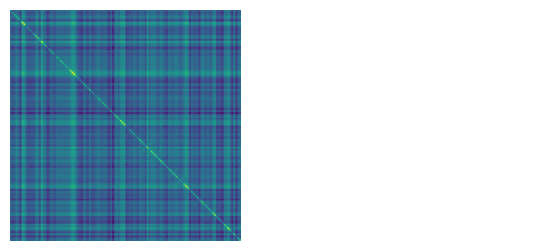

...

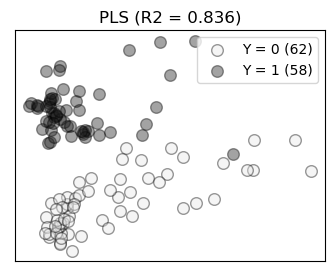

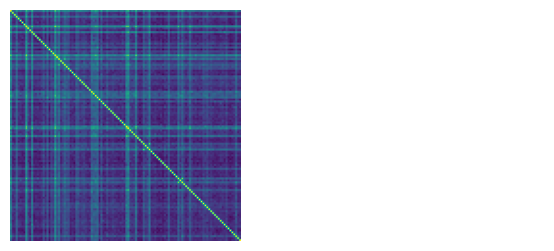

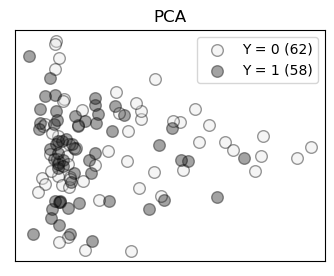

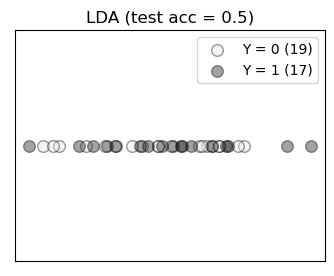

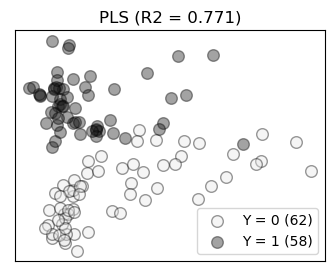

R[write to console]: Error in La.svd(x, nu, nv) : error code 1 from Lapack routine 'dgesdd'

R[write to console]: In addition: 
R[write to console]: There were 50 or more warnings (use warnings() to see the first 50)
R[write to console]: 



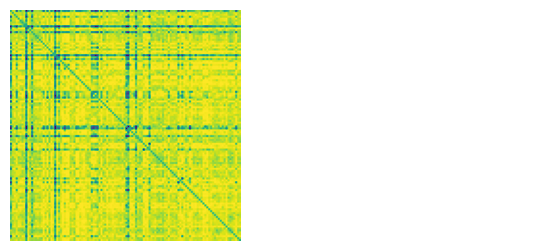

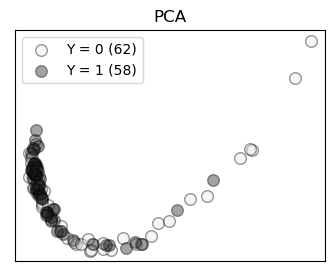

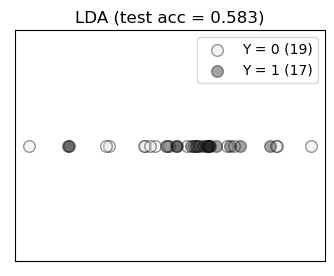

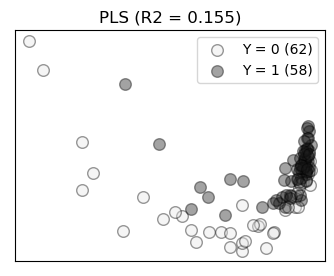

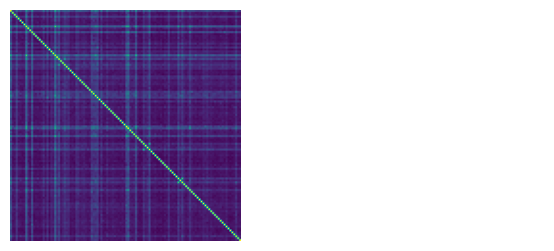

...

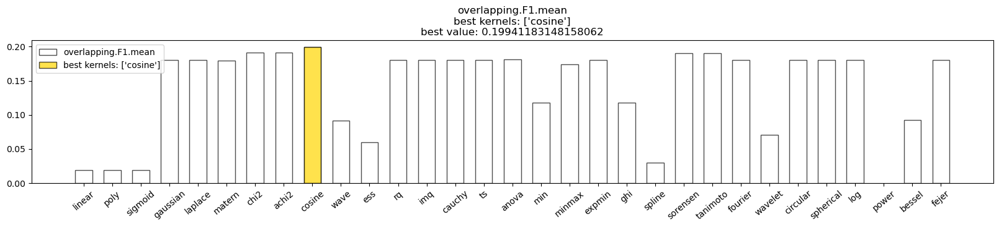

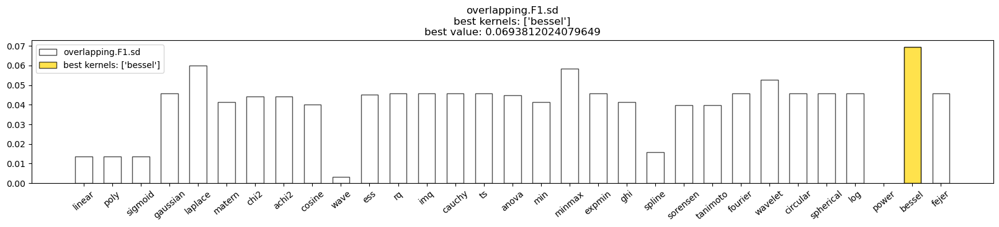

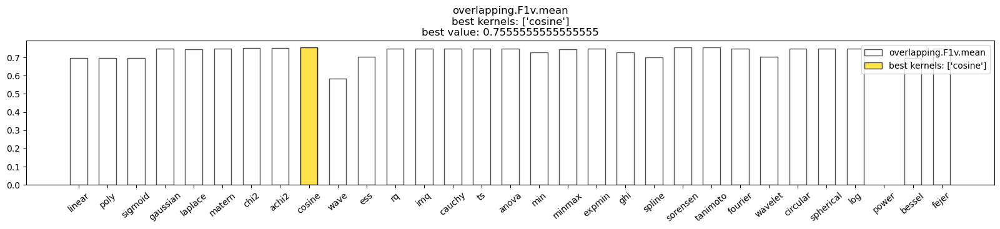

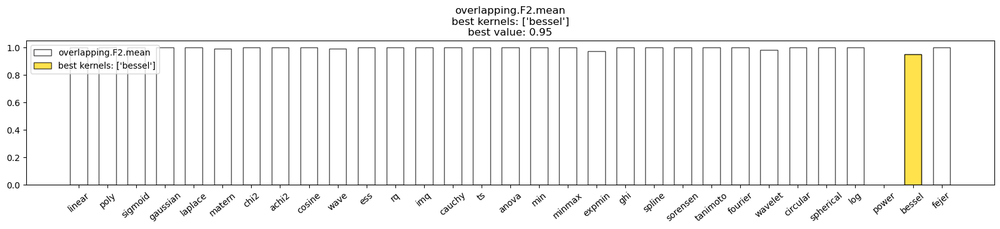

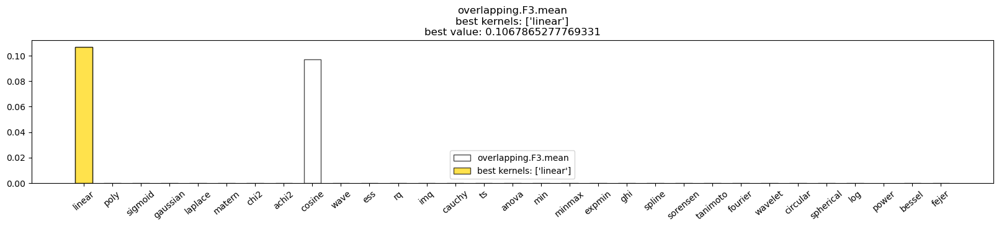

All-NaN slice encountered


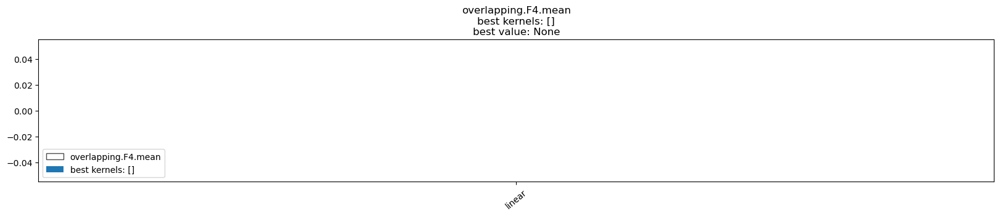

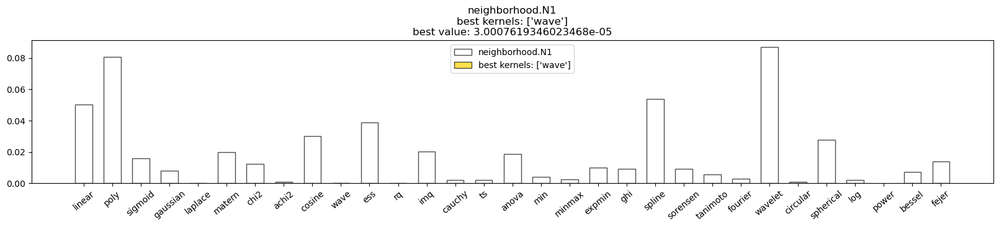

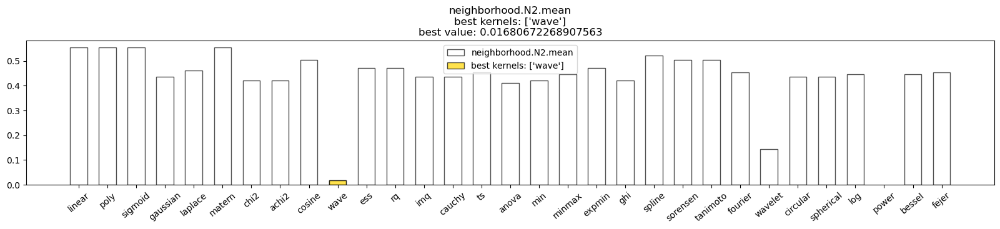

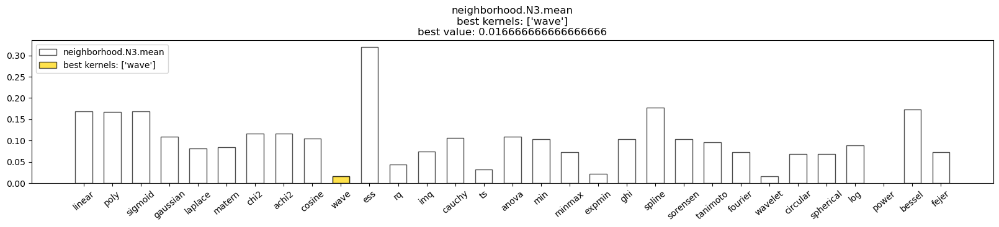

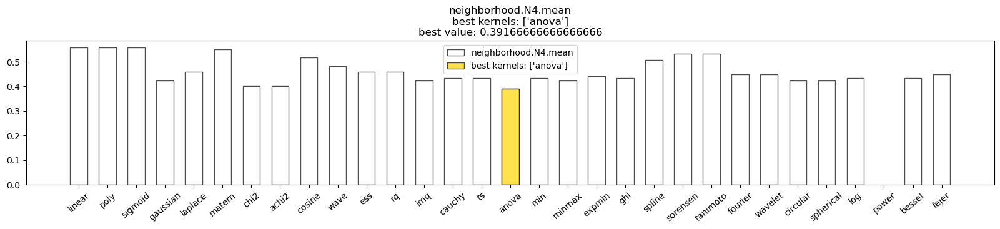

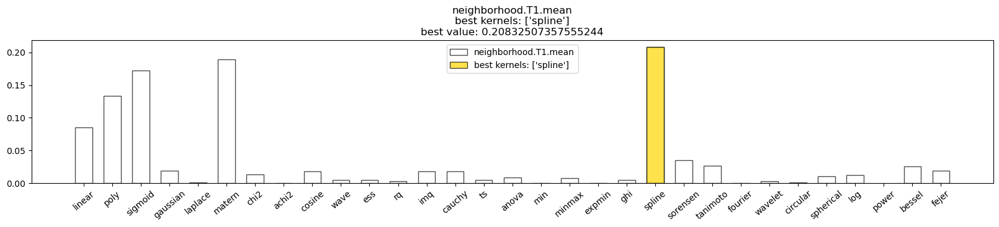

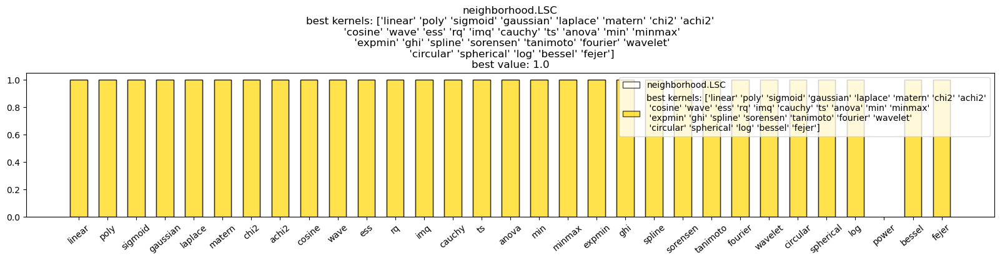

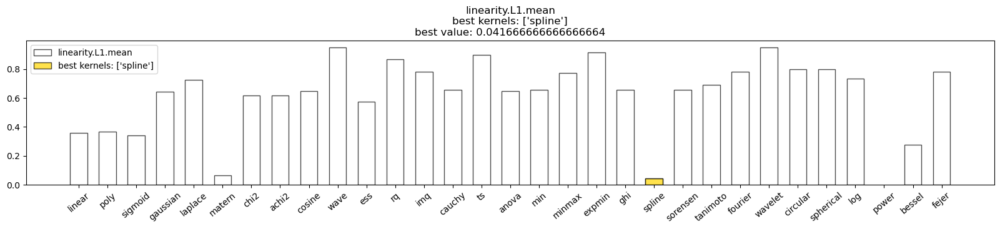

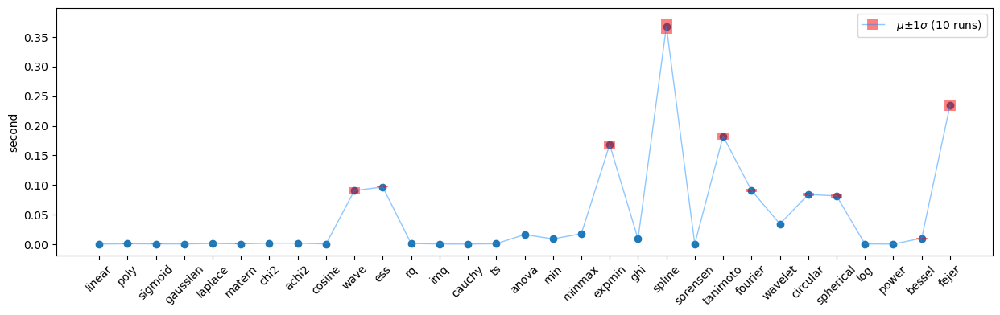

Averaged run time:  {'linear': 0.00045832999999220194, 'poly': 0.0009959799999819552, 'sigmoid': 0.0007426100000088809, 'gaussian': 0.0006799099999966529, 'laplace': 0.0014662499999872126, 'matern': 0.0008433799999806979, 'chi2': 0.0020015999999941415, 'achi2': 0.0019682299999999485, 'cosine': 0.0006424900000297385, 'wave': 0.09079832999999553, 'ess': 0.09669497999999521, 'rq': 0.0014164199999868287, 'imq': 0.0005440899999939574, 'cauchy': 0.000514500000008411, 'ts': 0.0009912099999951351, 'anova': 0.016528690000029655, 'min': 0.009170759999994971, 'minmax': 0.01792620999999599, 'expmin': 0.16818033999999216, 'ghi': 0.009094059999995352, 'spline': 0.3676680400000123, 'sorensen': 0.0005108700000050703, 'tanimoto': 0.18244886999998472, 'fourier': 0.09100245000000769, 'wavelet': 0.03452852999997731, 'circular': 0.08403933999999254, 'spherical': 0.08175629999997228, 'log': 0.0006692300000167961, 'power': 0.0004999199999929261, 'bessel': 0.010230209999997441, 'fejer': 0.23460240000000568}


In [5]:
analyze_dataset('salt')

load dataset from 7345.csv
Use classes: [0, 3], remapped to [0, 1]
X.shape (153, 3000)  y.shape (153,)


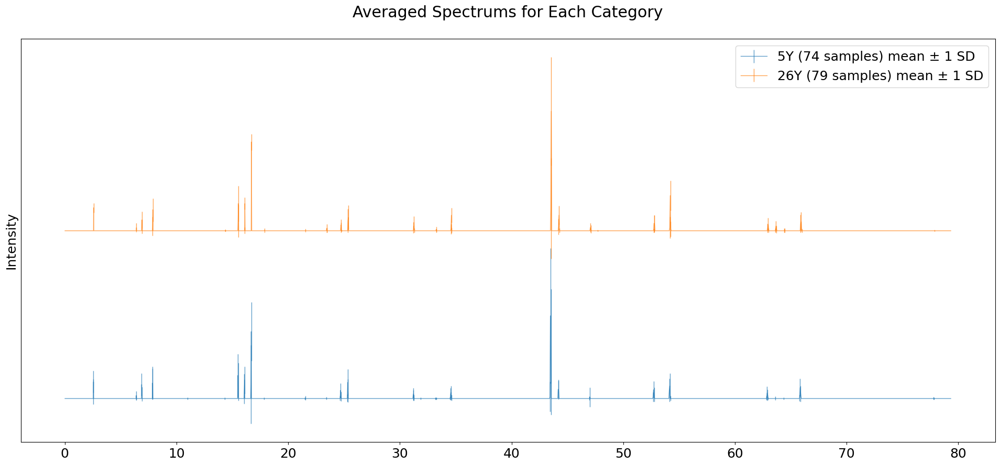

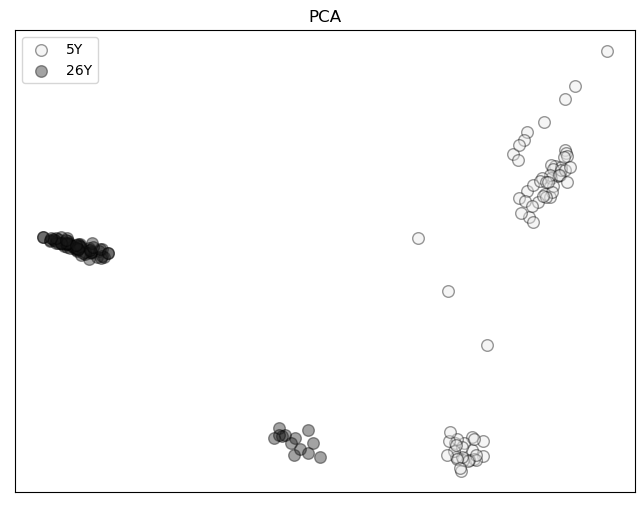

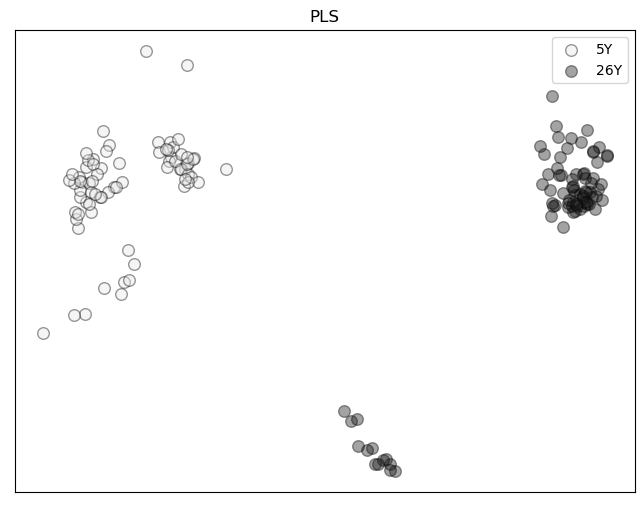

古井贡酒不同年份白酒 SPI-MS of Gujing Tribute wine of different vintages

["5年","8年","16年","26年"]

--------------------
If you use this data set, please add the reference: 
[1] Analytical chemistry kernel library for spectroscopic profiling data, Food Chemistry Advances, Volume 3, 2023, 100342, ISSN 2772-753X, https://doi.org/10.1016/j.focha.2023.100342


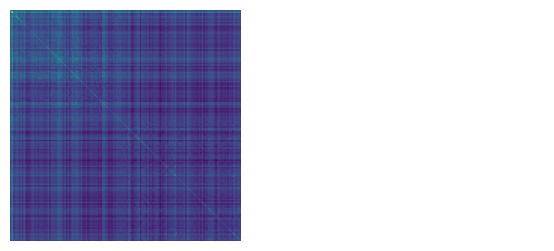

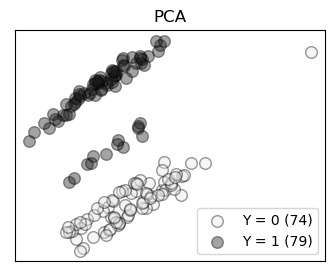

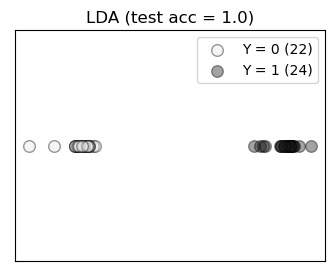

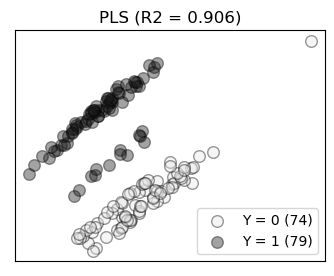

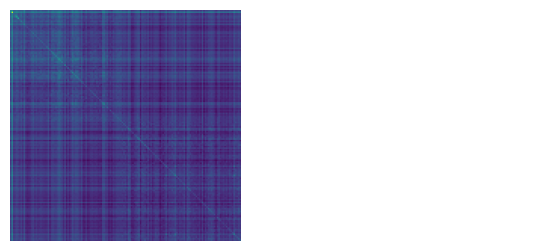

...

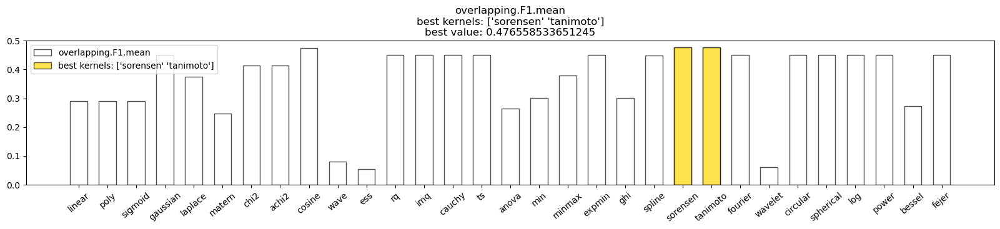

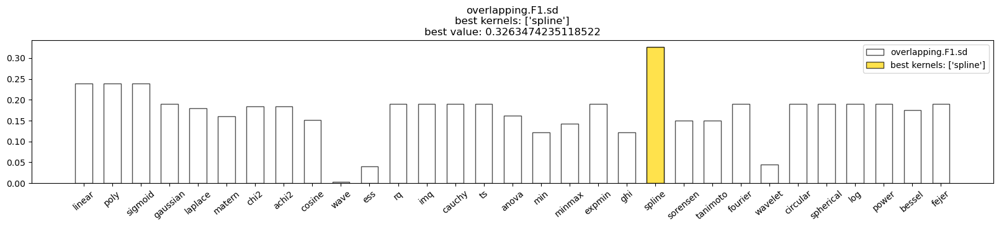

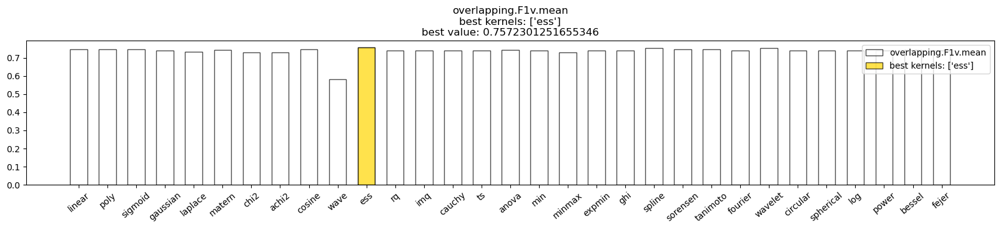

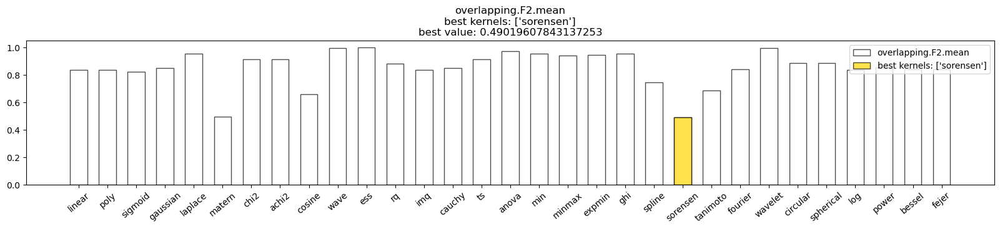

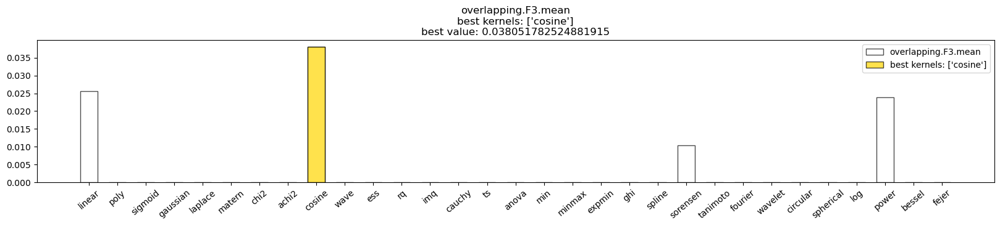

All-NaN slice encountered


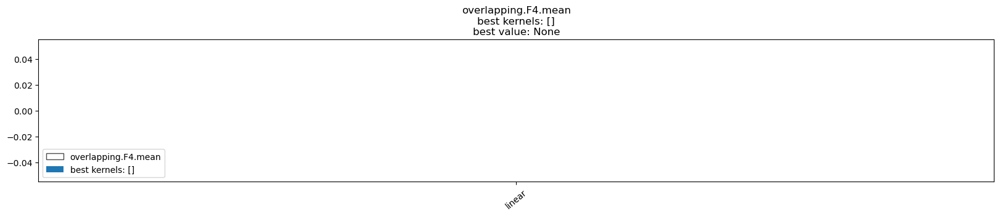

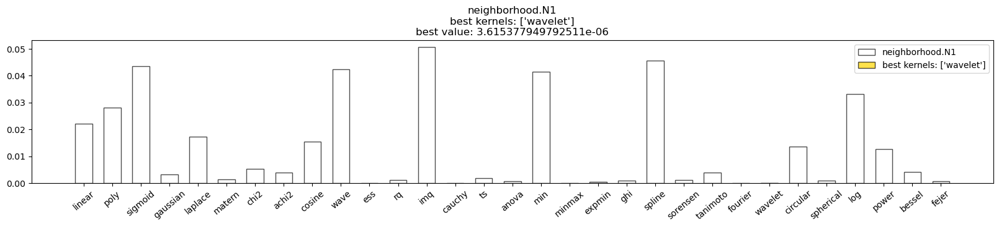

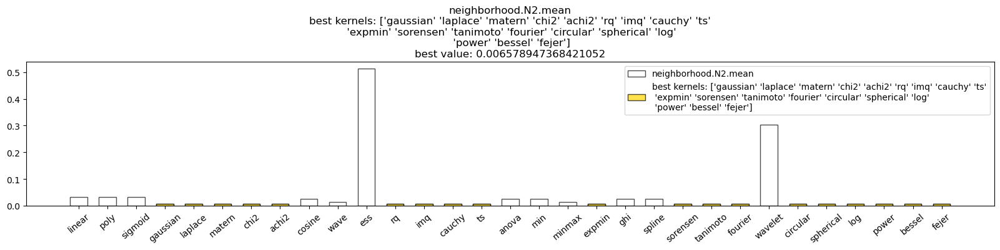

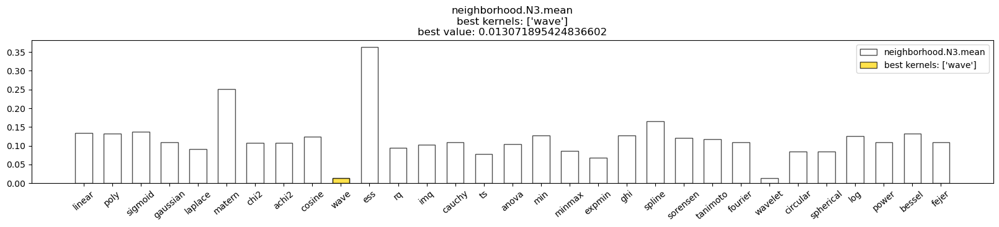

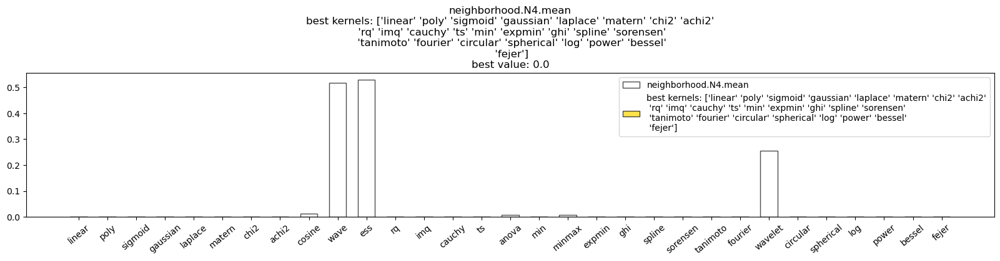

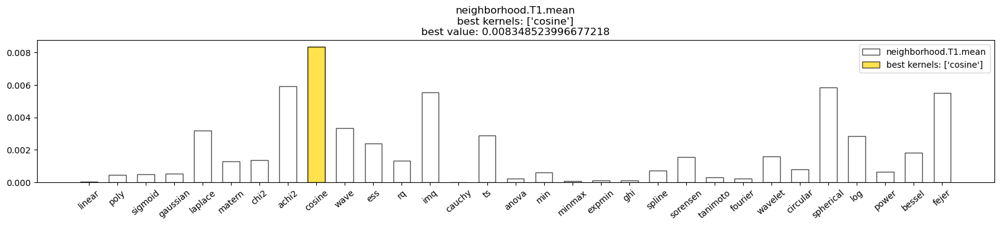

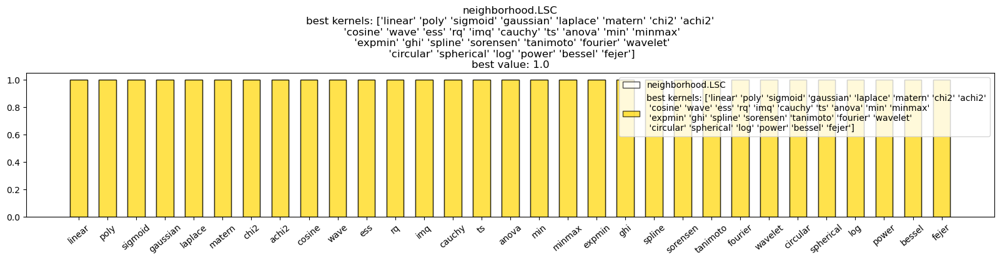

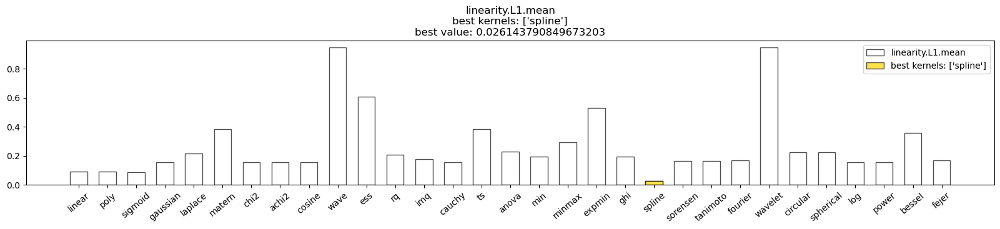

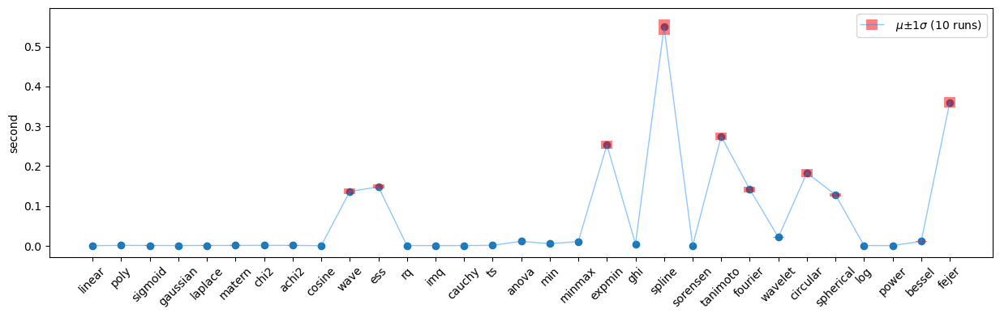

Averaged run time:  {'linear': 0.0005466799999794602, 'poly': 0.0013830500000494793, 'sigmoid': 0.001084330000094269, 'gaussian': 0.0008865599999808183, 'laplace': 0.001119349999953556, 'matern': 0.0012047600000641978, 'chi2': 0.0013795100001061655, 'achi2': 0.001251810000030673, 'cosine': 0.0006368899999415589, 'wave': 0.13642331000000923, 'ess': 0.14827712999999676, 'rq': 0.0009344399999463348, 'imq': 0.0007889499999691907, 'cauchy': 0.0007934700000532757, 'ts': 0.0015247799999997369, 'anova': 0.01161320999990494, 'min': 0.005436299999928451, 'minmax': 0.011002659999985554, 'expmin': 0.25333117000000127, 'ghi': 0.004901580000023387, 'spline': 0.5487732599999617, 'sorensen': 0.000639729999966221, 'tanimoto': 0.27472876000001634, 'fourier': 0.1419227100000171, 'wavelet': 0.021637970000028872, 'circular': 0.1831912099999954, 'spherical': 0.12814313000003494, 'log': 0.000984770000059143, 'power': 0.0007640200000423647, 'bessel': 0.011423900000045251, 'fejer': 0.36008960000012846}


In [6]:
analyze_dataset('vintage')

</br></br><hr/></br></br>

# Appendix

## linear kernel. 

Some algorithms with a preceding linear kernel equal to their non-kernel counterparts, e.g., linear-kernel-PCA is the same as vanilla PCA.

Verify linear-kernel-PCA equals vanilla PCA

load dataset from 7545.csv
X.shape (120, 600)  y.shape (120,)


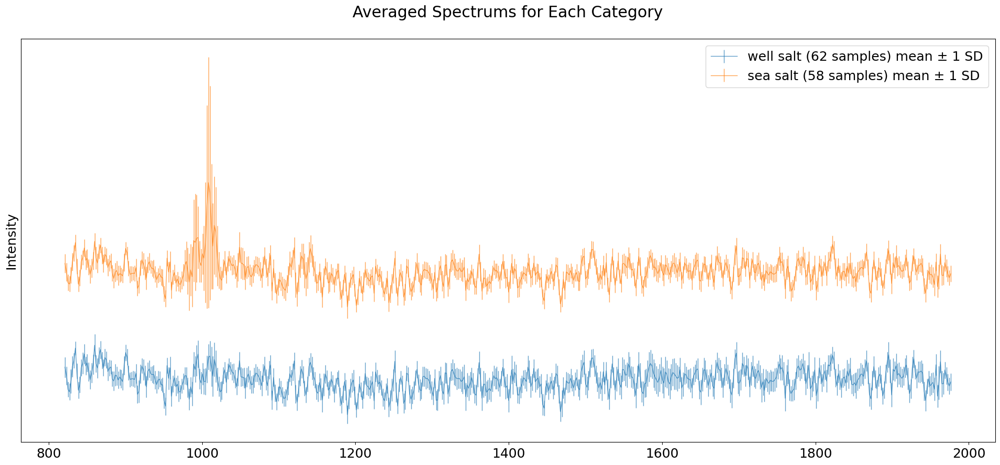

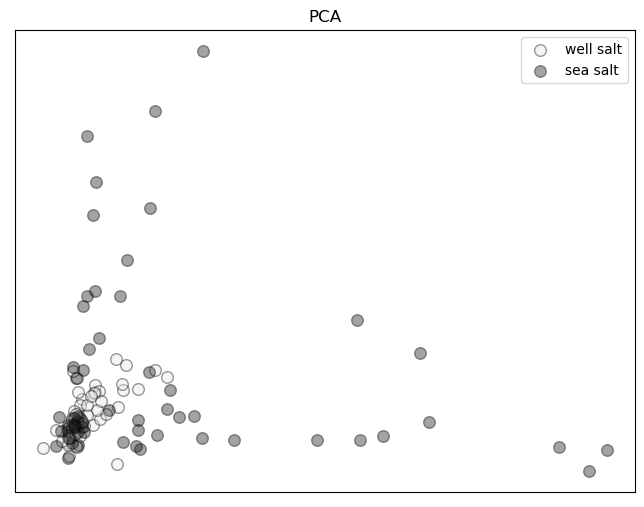

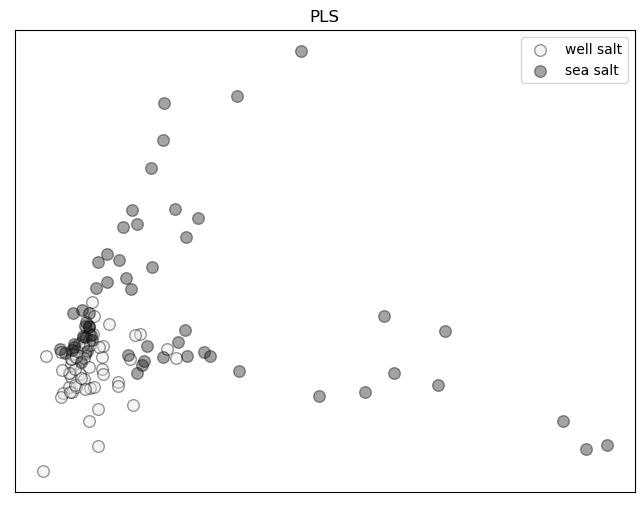

食盐拉曼光谱

C1 - "shenjinkuangyan(zhongyan)：深井矿盐（中盐集团）加碘盐", 
“deep well mineral salt” from CNSIC (China National Salt Industry Co.,Ltd).

C2 - "aozhoutianranhaiyan(huaiyan)：澳洲天然海盐（淮盐）未加碘",
“Australian natural sea salt” from Suyan Group.

DXR2xi显微拉曼成像光谱仪（美国Thermo Fisher公司），
配备有532 nm激光器。
仪器参数设置：
激光功率为10 mw，曝光时间1 s，扫描次数500，
拉曼位移范围为100～3000 cm-1。

--------------------
If you use this data set, please add the reference: 
[1] Analytical chemistry kernel library for spectroscopic profiling data, Food Chemistry Advances, Volume 3, 2023, 100342, ISSN 2772-753X, https://doi.org/10.1016/j.focha.2023.100342


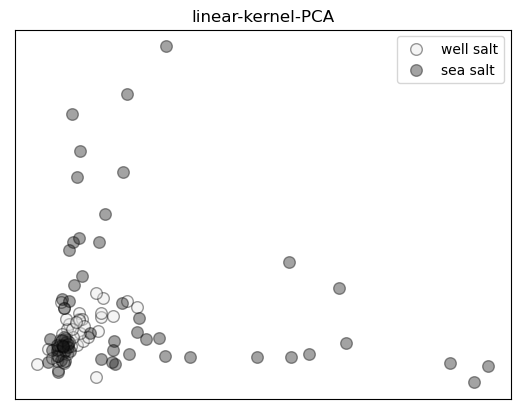

In [11]:
from sklearn.decomposition import KernelPCA
import matplotlib.pyplot as plt
from qsi.vis import plot_components_2d

X, y, X_names, desc, labels = io.load_dataset('salt', x_range = list(range(400,1000)), shift = 200, display=True)

transformer = KernelPCA(n_components=2, kernel='linear')
X_kpca = transformer.fit_transform(X)
# plt.scatter(X_kpca[:,0], X_kpca[:,1]
plot_components_2d(X_kpca, y, legends = labels)
plt.title('linear-kernel-PCA')
plt.show()

It's identical to the PCA plot.

## Tanh as an alternative function in neural networks

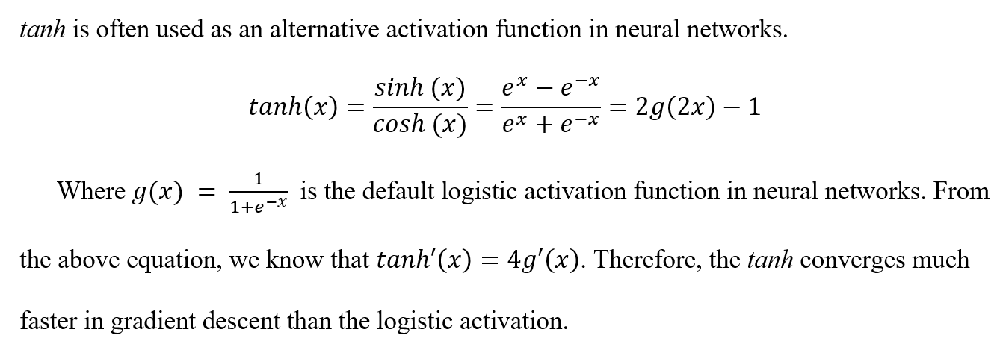

## Wavelet Kernel

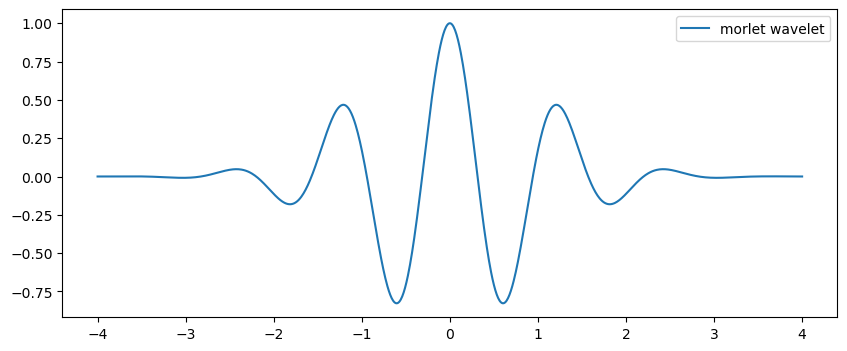

In [12]:
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize = (10,4))

x = np.linspace(-4,4,1000)
Y = np.cos(5*x) * np.exp(-x**2 / 2)
s = np.sum(Y)
plt.plot(x,Y,label = 'morlet wavelet')    
plt.legend()
plt.show()

In [13]:
# import sympy
from sympy import *

x = symbols('x')
expr = cos(5*x) * exp(-x**2 / 2)

# Use sympy.Integral() method
expr_intg = Integral(expr, (x, -oo,+oo) )

expr_intg
# integrate(expr, (x, 0,+oo) )

Integral(exp(-x**2/2)*cos(5*x), (x, -oo, oo))

In [14]:
expr_intg.doit()

sqrt(2)*sqrt(pi)*exp(-25/2)

A wavelet should satisfy the zero-mean "admissibility" condition, i.e., first moment is 0. This wavelet (morlet) has a near-zero first moment.

## Wave kernel

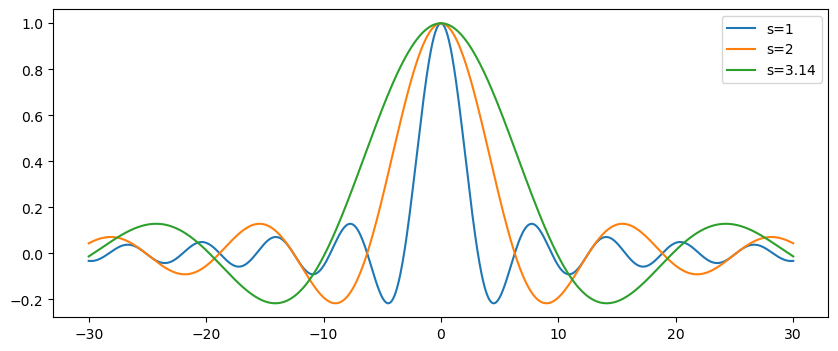

In [15]:
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize = (10,4))

for s in [1, 2, 3.14]:

    x = np.linspace(-30,30,1000) #np.linspace(-1/q,1/q,100)
    Y = s/x * np.sin(x/s)
    plt.plot(x,Y,label = 's='+str(s))
    
plt.legend()

## Draw the inner function of Fourier kerenl

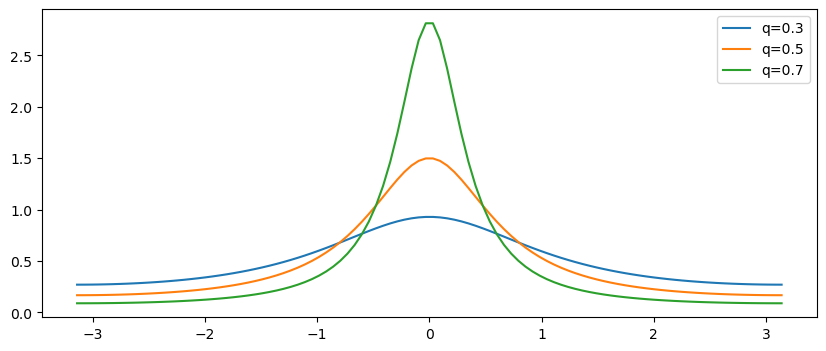

In [16]:
q = 0.5

plt.figure(figsize = (10,4))

for q in [0.3, 0.5, 0.7]:

    x = np.linspace(-3.14,3.14,100) #np.linspace(-1/q,1/q,100)
    H = (1- q ** 2) / (2.*(1. - 2.*q * np.cos(x) + q ** 2))
    plt.plot(x,H,label = 'q='+str(q))
    
plt.legend()

## Draw the spherical kernel against the pair-wise distance.

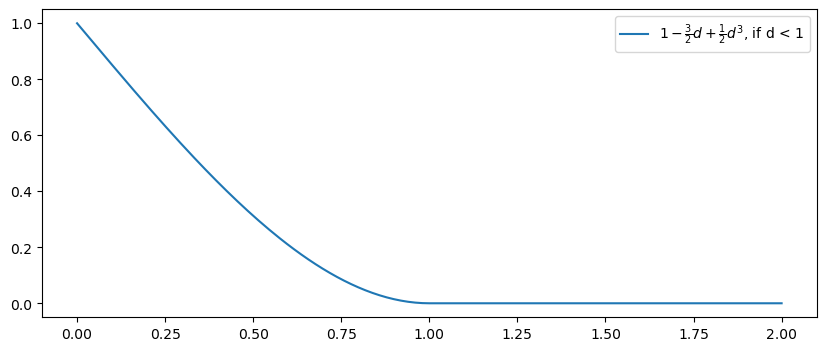

In [17]:
plt.figure(figsize = (10,4))

x = np.linspace(0,1,100) #np.linspace(-1/q,1/q,100)
x2 = list(np.linspace(1,2,100))
Y = list(1 - 3/2*x + 1/2*(x)**3)
Y2 = [0]*100
plt.plot(list(x)+x2,Y+Y2, label = r'$1 - \frac{3}{2}{d} + \frac{1}{2} { d }^3$, if d < 1') 
plt.legend()

## Circular kernel

$k(x, y) = \frac{2}{\pi} \arccos ( \frac{ \lVert x-y \rVert}{\sigma}) - \frac{2}{\pi} \frac{ \lVert x-y \rVert}{\sigma} \sqrt{1 - {\left( \frac{ \lVert x-y \rVert}{\sigma} \right)}^2 } $

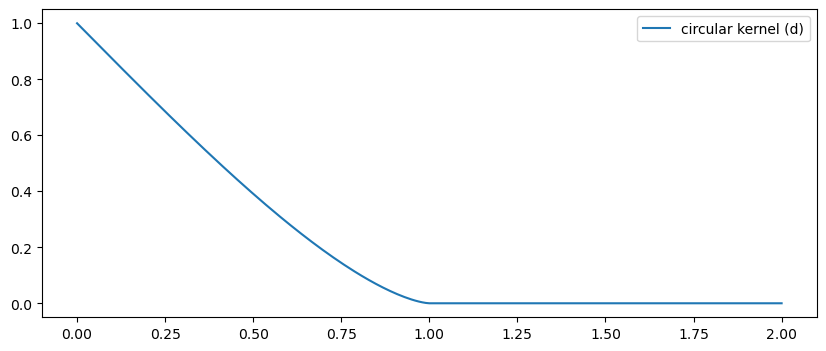

In [18]:
import math
plt.figure(figsize = (10,4))

x = np.linspace(0,1,100) #np.linspace(-1/q,1/q,100)
x2 = list(np.linspace(1,2,100))
Y = list( - 2/math.pi * x * np.sqrt(1-x**2) + 2 /math.pi * np.arccos(x)  )
Y2 = [0]*100
plt.plot(list(x)+x2,Y+Y2, label = 'circular kernel (d)') 
plt.legend()

## Draw the Fejér kernel curves against the pair-wise distance d at different n values.

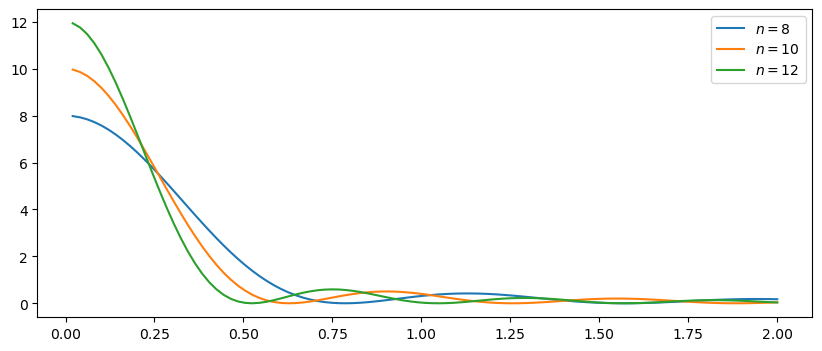

In [19]:
plt.figure(figsize = (10,4))

for n in [8, 10, 12]:
    x = np.linspace(0,2, 100) # np.linspace(-1/q,1/q,100)
    Y = (1- np.cos(n*x) ) / ( 1 - np.cos(x)) / n
    plt.plot(x, Y, label = '$n = ' + str(n)+'$') 
plt.legend()

# package versions

In [20]:
import numpy
import pandas
import matplotlib
import time
import sklearn
import scipy
import IPython
import statsmodels
import qsi
import cla
import ackl

!python -V
print("IPython " + IPython.__version__)
print("numpy " + numpy.__version__)
print("sklearn " + sklearn.__version__)
print("scipy " + scipy.__version__)
print("statsmodels " + statsmodels.__version__)
print("matplotlib " + matplotlib.__version__)
print("qsi-tk " + qsi.__version__)
print("cla " + cla.__version__)
print("ackl " + ackl.__version__)

Python 3.9.12IPython 8.4.0
numpy 1.22.4
sklearn 1.2.2
scipy 1.7.3
statsmodels 0.13.2
matplotlib 3.5.1
qsi-tk 0.6.0
cla 1.2.0
ackl 1.1.0



<br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><hr/>